<a href="https://colab.research.google.com/github/sunfflur/frequency-learning/blob/master/ODR/Exp_ODR2_a.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Experiment ODR2

`Author:` [sunfflur](https://github.com/sunfflur)

> Experiment ODR2 uses 2 classes - normal and cataract - from Ocular Disease Recognition dataset. 3 levels of splitting were considered. A preprocessing stage is implemented to keep data from the same patient in the same set (train, validation or test sets).


---

#### Setup

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import plotly.express as px
from PIL import Image
from skimage.transform import resize
import zipfile
from skimage.io import imread
import io
from os import listdir
import cv2
import random
from tqdm import tqdm
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Layer, Dense, Conv1D, Dropout, MaxPooling2D, Flatten
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import SGD, Adam
from sklearn.metrics import confusion_matrix
import seaborn as sn
from tensorflow.keras.utils import to_categorical, image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing.image import load_img,img_to_array
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

!pip install tensorflow-addons 
!pip install tensorflow-recommenders

import tensorflow_addons as tfa
import tensorflow_recommenders as tfrs

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 kB 10.1 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.2/96.2 kB 3.7 MB/s eta 0:00:00


In [ ]:
#Configuration environment

import os

os.environ['KAGGLE_USERNAME'] = "nataliacanto"

# username from the json file

os.environ['KAGGLE_KEY'] = "22dfa81f4539576eee33ca26ac952deb"

# key from the json file

In [ ]:
#!kaggle datasets download -d paultimothymooney/breast-histopathology-images
!kaggle datasets download -d andrewmvd/ocular-disease-recognition-odir5k

 99% 1.61G/1.62G [00:17<00:00, 140MB/s]
100% 1.62G/1.62G [00:17<00:00, 101MB/s]


In [ ]:
!unzip -q '/content/ocular-disease-recognition-odir5k.zip'

#### Drive mount

In [ ]:
!sudo add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!sudo apt-get update -qq 2>&1 > /dev/null
!sudo apt -y install -qq google-drive-ocamlfuse 2>&1 > /dev/null
!google-drive-ocamlfuse



debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
/usr/bin/xdg-open: 869: www-browser: not found
/usr/bin/xdg-open: 869: links2: not found
/usr/bin/xdg-open: 869: elinks: not found
/usr/bin/xdg-open: 869: links: not found
/usr/bin/xdg-open: 869: lynx: not found
/usr/bin/xdg-open: 869: w3m: not found
xdg-open: no method available for opening 'https://accounts.google.com/o/oauth2/auth?client_id=564921029129.apps.googleusercontent.com&redirect_uri=https%3A%2F%2Fgd-ocaml-auth.appspot.com%2Foauth2callback&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&access_type=offline&

In [ ]:
!sudo apt-get install -qq w3m # to act as web browser 
!xdg-settings set default-web-browser w3m.desktop # to set default browser
%cd /content
!mkdir drive
%cd drive
!mkdir MyDrive
%cd ..
%cd ..
!google-drive-ocamlfuse /content/drive/MyDrive

debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package w3m.
(Reading database ... 122536 files and directories currently installed.)
Preparing to unpack .../w3m_0.5.3-37ubuntu0.1_amd64.deb ...
Unpacking w3m (0.5.3-37ubuntu0.1) ...
Setting up w3m (0.5.3-37ubuntu0.1) ...
Processing triggers for man-db (2.9.1-1) ...
Processing triggers for mime-support (3.64ubuntu1) ...
/content
/content/drive
/content
/
Access token retrieved correctly.


#### Data

In [ ]:
df = pd.read_csv('/content/full_df.csv')

In [ ]:
df.head()

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,C,A,H,M,O,filepath,labels,target,filename
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,1,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,0,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,0,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg


In [ ]:
df['Left-Diagnostic Keywords'].values

array(['cataract', 'normal fundus',
       'laser spot，moderate non proliferative retinopathy', ...,
       'mild nonproliferative retinopathy',
       'mild nonproliferative retinopathy',
       'hypertensive retinopathy，age-related macular degeneration'],
      dtype=object)

In [ ]:
def has_normal(text):
    if "normal" in text:
        return 1
    else:
        return 0
def has_cataract(text):
    if "cataract" in text:
        return 1
    else:
        return 0

In [ ]:
df["left_cataract"] = df["Left-Diagnostic Keywords"].apply(lambda x: has_cataract(x))
df["right_cataract"] = df["Right-Diagnostic Keywords"].apply(lambda x: has_cataract(x))
df

,ID,Patient Age,Patient Sex,Left-Fundus,Right-Fundus,Left-Diagnostic Keywords,Right-Diagnostic Keywords,N,D,G,...,A,H,M,O,filepath,labels,target,filename,left_cataract,right_cataract
0,0,69,Female,0_left.jpg,0_right.jpg,cataract,normal fundus,0,0,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",0_right.jpg,1,0
1,1,57,Male,1_left.jpg,1_right.jpg,normal fundus,normal fundus,1,0,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['N'],"[1, 0, 0, 0, 0, 0, 0, 0]",1_right.jpg,0,0
2,2,42,Male,2_left.jpg,2_right.jpg,laser spot，moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,...,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",2_right.jpg,0,0
3,4,53,Male,4_left.jpg,4_right.jpg,macular epiretinal membrane,mild nonproliferative retinopathy,0,1,0,...,0,0,0,1,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4_right.jpg,0,0
4,5,50,Female,5_left.jpg,5_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",5_right.jpg,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6387,4686,63,Male,4686_left.jpg,4686_right.jpg,severe nonproliferative retinopathy,proliferative diabetic retinopathy,0,1,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4686_left.jpg,0,0
6388,4688,42,Male,4688_left.jpg,4688_right.jpg,moderate non proliferative retinopathy,moderate non proliferative retinopathy,0,1,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4688_left.jpg,0,0
6389,4689,54,Male,4689_left.jpg,4689_right.jpg,mild nonproliferative retinopathy,normal fundus,0,1,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4689_left.jpg,0,0
6390,4690,57,Male,4690_left.jpg,4690_right.jpg,mild nonproliferative retinopathy,mild nonproliferative retinopathy,0,1,0,...,0,0,0,0,../input/ocular-disease-recognition-odir5k/ODI...,['D'],"[0, 1, 0, 0, 0, 0, 0, 0]",4690_left.jpg,0,0


In [ ]:
df.loc[(df.right_cataract ==1) & (df.left_cataract == 1)] #192 pacientes tem catarata nos dois olhos

In [ ]:
left_cataract = df.loc[(df.C ==1) & (df.left_cataract == 1)]["Left-Fundus"].values
left_cataract[:15]

array(['0_left.jpg', '81_left.jpg', '103_left.jpg', '119_left.jpg',
       '254_left.jpg', '294_left.jpg', '330_left.jpg', '448_left.jpg',
       '465_left.jpg', '477_left.jpg', '553_left.jpg', '560_left.jpg',
       '594_left.jpg', '611_left.jpg', '625_left.jpg'], dtype=object)

In [ ]:
right_cataract = df.loc[(df.C ==1) & (df.right_cataract == 1)]["Right-Fundus"].values
right_cataract[:15]

array(['24_right.jpg', '81_right.jpg', '112_right.jpg', '188_right.jpg',
       '218_right.jpg', '345_right.jpg', '354_right.jpg', '477_right.jpg',
       '553_right.jpg', '560_right.jpg', '625_right.jpg', '726_right.jpg',
       '769_right.jpg', '949_right.jpg', '955_right.jpg'], dtype=object)

In [ ]:
print("Number of images in left cataract: {}".format(len(left_cataract)))
print("Number of images in right cataract: {}".format(len(right_cataract)))

Number of images in left cataract: 304
Number of images in right cataract: 290


In [ ]:
left_normal = df.loc[(df.C ==0) & (df["Left-Diagnostic Keywords"] == "normal fundus")]["Left-Fundus"].sample(250,random_state=42).values
right_normal = df.loc[(df.C ==0) & (df["Right-Diagnostic Keywords"] == "normal fundus")]["Right-Fundus"].sample(250,random_state=42).values
right_normal[:15]

array(['2964_right.jpg', '680_right.jpg', '500_right.jpg',
       '2368_right.jpg', '2820_right.jpg', '2769_right.jpg',
       '2696_right.jpg', '2890_right.jpg', '940_right.jpg',
       '2553_right.jpg', '3371_right.jpg', '3042_right.jpg',
       '919_right.jpg', '3427_right.jpg', '379_right.jpg'], dtype=object)

In [ ]:
print("Number of images in left normal: {}".format(len(left_normal)))
print("Number of images in right normal: {}".format(len(right_normal)))

Number of images in left normal: 250
Number of images in right normal: 250


In [ ]:
cataract = np.concatenate((left_cataract,right_cataract),axis=0)
normal = np.concatenate((left_normal,right_normal),axis=0)

#### Partitioning by index

In [ ]:
df.loc[(df.right_cataract == 1)]["ID"]

20        24
65        81
93       112
160      188
186      218
        ... 
4697    2243
4698    2246
4699    2247
4700    2248
4702    2282
Name: ID, Length: 290, dtype: int64

In [ ]:
df.loc[(df.left_cataract == 1)]['ID']

0          0
65        81
86       103
100      119
218      254
        ... 
4697    2243
4698    2246
4699    2247
4700    2248
4701    2262
Name: ID, Length: 304, dtype: int64

In [ ]:
df.loc[(df.right_cataract == 1)]["ID"] | df.loc[(df.left_cataract == 1)]['ID']

0       False
20       True
65       True
86      False
93       True
        ...  
4698     True
4699     True
4700     True
4701    False
4702     True
Name: ID, Length: 402, dtype: bool

In [ ]:
a=np.logical_or(df[['ID', 'right_cataract',  'left_cataract', 'Left-Fundus', 'Right-Fundus']]['right_cataract']==1, df[['ID', 'right_cataract',  'left_cataract', 'Left-Fundus', 'Right-Fundus']]['left_cataract']==1)

In [ ]:
np.where(a==True)

In [ ]:
df_2=df[['ID', 'right_cataract',  'left_cataract', 'Left-Fundus', 'Right-Fundus', 'C', 'N']]

In [ ]:
df_2

In [ ]:
df_3 = np.logical_or(df_2['C']==1, df_2['N']==1)

In [ ]:
df_3

In [ ]:
df_4 = df_2[df_3]

In [ ]:
a=np.logical_or(df_4['left_cataract']==1, df_4['right_cataract']==1)

In [ ]:
b=np.logical_and(df_4['left_cataract']==0, df_4['right_cataract']==0)

In [ ]:
cataract = df_4[a]

In [ ]:
sum(cataract['right_cataract']==1)

290

In [ ]:
sum(cataract['left_cataract']==1)

304

In [ ]:
(594-210)/2

192.0

In [ ]:
normal = df_4[b].sample(192,random_state=42)

In [ ]:
normal

In [ ]:
# concatenate the two dataframes into one
df_filtered = pd.concat([cataract, normal], ignore_index=True)

In [ ]:
df_filtered.values[0]

array([0, 0, 1, '0_left.jpg', '0_right.jpg', 1, 0], dtype=object)

In [ ]:
test=[]
for (idx, element) in enumerate(df_filtered.values):
  #print(len(idx),len(element))
  #test.append([idx,element[3], element[2]])
  #test.append([idx,element[4], element[1]])
  test.append(([idx,element[3], element[2] ],[idx,element[4], element[1]]))

In [ ]:
test

In [ ]:
dados = np.asarray(test)

In [ ]:
dados.shape

(594, 2, 3)

In [ ]:
# numero de images com catarata
sum(dados[:, 2]=='1')

594

In [ ]:
dados_shuffled = dados.copy()

In [ ]:
np.random.shuffle(dados_shuffled)

In [ ]:
train = dados_shuffled[:int(0.6*len(dados_shuffled))]

In [ ]:
train.shape

(356, 2, 3)

In [ ]:
train2 = np.asarray(train).reshape(356*2, 3)

In [ ]:
valid = dados_shuffled[int(0.6*len(dados_shuffled)):int(0.7*len(dados_shuffled))]

In [ ]:
valid2 = np.asarray(valid).reshape(59*2, 3)

In [ ]:
test = dados_shuffled[int(0.7*len(dados_shuffled)):]

In [ ]:
test.shape

(179, 2, 3)

In [ ]:
test2 = np.asarray(test).reshape(179*2, 3)

In [ ]:
test2.shape

(358, 3)

In [ ]:
train2[train2== '1'].shape

(375,)

In [ ]:
train2[train2== '0'].shape

(339,)

In [ ]:
valid2[valid2== '1'].shape

(43,)

In [ ]:
valid2[valid2== '0'].shape

(75,)

In [ ]:
test2[test2 == '0'].shape

(182,)

In [ ]:
test2[test2 == '1'].shape

(178,)

#### Dataset

In [ ]:
dataset_dir = "/content/preprocessed_images/"
image_size=512

def create_set(dataset):
  data = []
  for i in dataset:
    img, label = i[1], int(i[2])
    image_path = os.path.join(dataset_dir, img)
    #print(image_path)
    try:
      image = cv2.cvtColor(cv2.imread(image_path,cv2.IMREAD_COLOR), cv2.COLOR_RGB2BGR)
      image = cv2.resize(image,(image_size,image_size))
    except:
      continue
    data.append([image, label])
    np.random.shuffle(data)
  #print(np.asarray(data).shape)#data = np.asarray(data)
  #print(np.asarray(data)[:,0].shape)
  x = []
  y = []
  for im in data:
    x.append(im[0])
    y.append(im[1])
  return np.asarray(x), to_categorical(np.asarray(y))
x_train, y_train = create_set(train2)
x_valid, y_valid = create_set(valid2)
x_test, y_test = create_set(test2)

In [ ]:
x_train.shape

(705, 512, 512, 3)

In [ ]:
y_train.shape

(705, 2)

In [ ]:
x_valid.shape

(117, 512, 512, 3)

In [ ]:
x_test.shape

(349, 512, 512, 3)

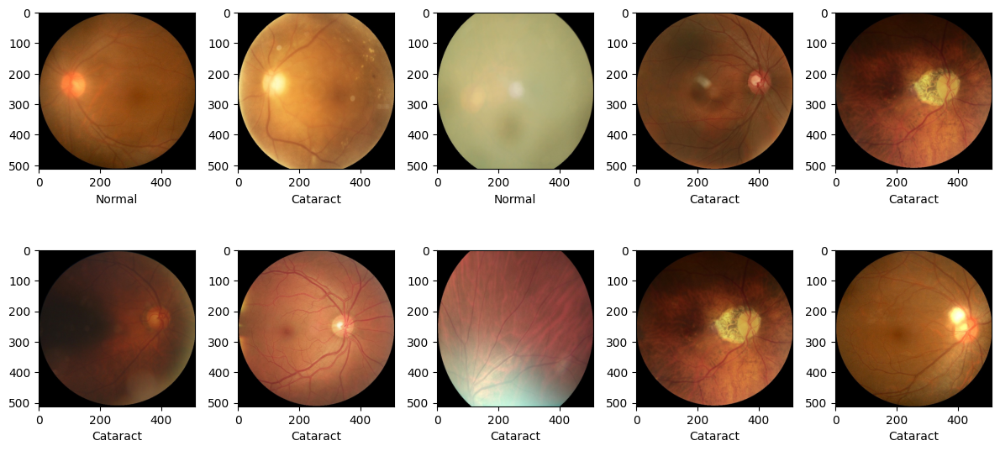

In [ ]:
dataset = x_train
labels = y_train
plt.figure(figsize=(12,6))
for i in range(10):
    sample = random.choice(range(len(dataset)))
    image = dataset[sample]
    #print(image.shape)
    category = labels[sample]
    #print(category)
    if category[0] == 0:
        label = "Normal"
    else:
        label = "Cataract"
    plt.subplot(2,5,i+1)
    plt.imshow(image)
    plt.xlabel(label)
plt.tight_layout()    

In [ ]:
path = '/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/'
np.save(path + 'x_train_odir2.npy', x_train)
np.save(path + 'y_train_odir2.npy', y_train)

np.save(path + 'x_valid_odir2.npy', x_valid)
np.save(path + 'y_valid_odir2.npy', y_valid)

np.save(path + 'x_test_odir2.npy', x_test)
np.save(path + 'y_test_odir2.npy', y_test)

#### Load original data

In [ ]:
x_train = np.load('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/x_train_odir2.npy')
y_train = np.load('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/y_train_odir2.npy')

x_valid = np.load('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/x_valid_odir2.npy')
y_valid = np.load('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/y_valid_odir2.npy')

x_test = np.load('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/x_test_odir2.npy')
y_test = np.load('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/y_test_odir2.npy')

In [ ]:
y_train.shape

(705, 2)

In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [ ]:
y_train[:15]

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [ ]:
images = [x_train[1], x_train[2], x_train[0], x_train[13],
          x_train[3], x_train[10], x_train[7], x_train[14]]

In [ ]:
# Create a subplot figure with 2 rows and 2 columns
fig = make_subplots(rows=2, cols=4)
# Add each image to the subplot figure
for i in range(8):
    row = i // 4 +1 # Calculate the row index
    col = i % 4 +1  # Calculate the column index
    #print(row, col)
    image = images[i]  # Get the image data or file path for the current image

    # Add the image to the subplot figure
    fig.add_trace(go.Image(z=image), row=row, col=col)

# Adjust horizontal spacing for the 2nd and 3rd columns
#fig.update_xaxes(col=2, matches='x', showticklabels=False, fixedrange=True)
#fig.update_xaxes(col=3, matches='x', showticklabels=False, fixedrange=True, range=[0.2, 0.5])
# Update the subplot layout
fig.update_layout(height=500, width=800)
# Hide the axes
fig.update_xaxes(showgrid=False, showticklabels=False, zeroline=False)
fig.update_yaxes(showgrid=False, showticklabels=False, zeroline=False)
# Add title for the first two columns
fig.add_annotation(text="Cataract", x=0.2, y=1.1, xref="paper", yref="paper", showarrow=False, font=dict(size=16))
# Add title for the last two columns
fig.add_annotation(text="Normal", x=0.8, y=1.1, xref="paper", yref="paper", showarrow=False, font=dict(size=16))
# Show the plot
fig.show()

#### Image Main Functions - Per Image

In [ ]:
### blocks PER IMAGE ###
def slice_data(images, levels):
  outputs = []
  if levels == 0:
    dim = int(tf.rank(images))
    if dim == 3:
      #print(images.shape)
      images = tf.expand_dims(images, -1)
      images = tf.transpose(images, [0, 3, 1, 2])
      return images
    else:
      images = tf.transpose(images, [0, 3, 1, 2])
      return images
  for image in images:
    #print('image shape?', image.shape)
    iM, iN = image.shape[0], image.shape[1] #512,512
    iMc, iNc = int(iM/2), int(iN/2) #512/2,512/2
    output = tf.stack((image[:iMc, :iNc], image[:iMc,iNc:], image[iMc:,:iNc], image[iMc:, iNc:]),-1)
    output = tf.reshape(output,[output.shape[0],output.shape[1], -1]) #256,256,4
    outputs.append(output)
  outputs = tf.convert_to_tensor(outputs)
  return slice_data(outputs, levels-1)

In [ ]:
### DFT PER IMAGE ### 
def m_spectrum(images):
  magnitudes = []
  for image in images:
    side = image.shape[1]
    inputx = tf.cast(image, tf.complex128) # change dtype to complex64
    fft = tf.signal.fft2d(inputx) # perform fast fourier transform
    fft_shift = tf.signal.fftshift(fft, axes=(1,2)) # shift the zero-frequency component to the center
    # calculate the magnitude and scale it
    magnitude = tf.math.abs(fft_shift)
    magnitude = tf.math.divide(magnitude, side**2) # do not change here !!!
    magnitude = tf.math.log(1+magnitude)
    magnitudes.append(magnitude)
  return tf.convert_to_tensor(magnitudes)

In [ ]:
def NormalizeData(X, max=1, min=0):
    ### data normalization between 0-1
    X_std = (X - tf.math.reduce_min(X)) / (tf.math.reduce_max(X) - tf.math.reduce_min(X))
    X_scaled = X_std * (max - min) + min
    return X_scaled

In [ ]:
### magnitude sums PER IMAGE ###

def create_circle(size=None, radius=None, width=None):
  image = np.zeros((size, size))
  center = (size-1) / 2 # c
  linhas=np.arange(0,size,1).reshape(size,1) # u
  colunas=np.arange(0,size,1).reshape(1,size) # v
  condition_1=(linhas-center)**2 # (u-c)^2
  condition_2=(colunas-center)**2 # (v-c)^2
  circulo=(condition_1 + condition_2) # eq do circulo: (u-c)^2 + (v-c)^2
  desigualdade=np.less_equal(np.sqrt(circulo),radius)
  desigualdade_2=np.greater(np.sqrt(circulo),(radius-width)) # max <= r
  return np.logical_and(desigualdade,desigualdade_2).astype(np.float64)

def radial_grouping(images, w):
  grouping = []
  for image in images:
    iM, iN = image.shape[1], image.shape[2] #image dimension
    iMc, iNc = int(iM/2), int(iN/2) #image center
    A = tf.range(-iMc,iNc)**2
    dists = tf.math.sqrt(tf.cast(A[:,None] + A, dtype=tf.float64))
    dists = tf.reshape(dists, [1,image.shape[1],image.shape[2]]) #1,512,512
    n = int(iNc/r) #rings number
    magnitude_sums = []
    ring = 0
    for j in range(1, 2*n, 2):
      ring = tf.cast((tf.abs(dists-(r/2)*j)<(r/2)), dtype=tf.float64)
      if j == 1:
        ring = tf.cast((tf.abs(dists-(r/2)*j)<=(r/2)), dtype=tf.float64)
      mult = tf.multiply(ring,image)
      sum = tf.reduce_sum(mult,axis=(1,2))
      magnitude_sums.append(sum.numpy())
    magnitude_sums = tf.convert_to_tensor(magnitude_sums)
    grouping.append(magnitude_sums)
  grouping = tf.convert_to_tensor(grouping)
  grouping = tf.reshape(grouping, [grouping.shape[0], -1])
  return grouping

In [ ]:
### magnitude sums PER IMAGE ###

def create_square(size=None, radius=None, width=None):
  image = np.zeros((size, size))
  center = (size-1) / 2
  linhas=np.arange(0,size,1).reshape(size,1) #u
  colunas=np.arange(0,size,1).reshape(1,size) #v
  condition_1=np.abs(linhas-center) # |x1-x2|
  condition_2=np.abs(colunas-center) # |y1-y2|
  maximo=np.maximum(condition_1,condition_2) # max(|x1-x2|,|y1-y2|)
  desigualdade=np.less_equal(maximo,radius)
  desigualdade_2=np.greater(maximo,radius-width) # max <= r
  return np.logical_and(desigualdade,desigualdade_2).astype(np.float64)

def square_grouping(images, w):
  grouping = []
  for image in images:
    iM, iN = image.shape[1], image.shape[2] #image dimension
    iMc, iNc = int(iM/2), int(iN/2) #image center
    #A = tf.range(-iMc,iNc)**2
    #n = int(iNc/r) #rings number
    #ring = np.full((iM,iN), 0)
    magnitude_sums = []
    #for w in range(r, (n*r)+1, r):
    for r in range(w, (iM//2)+1, w):
      ring = create_square(iM, r, w)
      #image = np.logical_or(squares(2*iMc,r), squares(2*iMc,r))
      ring = tf.convert_to_tensor(ring, dtype=tf.float64)
      #ring[iMc-w:iMc+w,iNc-w:iNc+w] = 1
      #ring[iMc-w + r :iMc+w -r ,iNc-w +r :iNc+w -r] = 0
      mult = tf.multiply(ring, image)
      #print(mult.shape)
      #print('mult:', mult)
      sum = tf.reduce_sum(mult,axis=(1,2))
      magnitude_sums.append(sum.numpy())
    magnitude_sums = tf.convert_to_tensor(magnitude_sums)
    grouping.append(magnitude_sums)
  grouping = tf.convert_to_tensor(grouping)
  grouping = tf.reshape(grouping, [grouping.shape[0], -1])
  return grouping

#### Data Pre-Process - 3 levels

In [ ]:
class PreProcess():
  def __init__(self, data, level, w): #level = levels number; r = radius (ring width);
    self.data = data #x_train/test
    self.level = level
    self.w = w
  def processing(self):
    conc_channels = []
    for i in range(0, self.level+1):
      print('level:', i)
      for j in range(0, self.data.shape[3]):
        print('channel:', j)
        sliced_data = slice_data(self.data[:,:,:,j], levels=i)
        #print('sliced:', sliced_data.shape)
        dft_data = m_spectrum(sliced_data)
        #grouping_data = radial_grouping(dft_data, r=self.r) # r = radius (ring width)
        grouping_data = square_grouping(dft_data, w=self.w) # r = radius (ring width)
        conc_channels.append(grouping_data)
        #del sliced_data
        #del dft_data
        #del grouping_data
      conc = tf.concat((conc_channels), axis=1)
    input = tf.concat((conc), axis=1)
    inp = NormalizeData(input)
    input = tf.convert_to_tensor(inp)
    return input, sliced_data, dft_data

In [ ]:
x_train.shape

(705, 512, 512, 3)

In [ ]:
with tf.device('/CPU:0'):
  input, sliced_data, dft_data = PreProcess(x_train, 2, 1).processing() #2 levels means original image + division in 4 blocks + division in 16 blocks (4 blocks again)

level: 0
channel: 0
channel: 1
channel: 2
level: 1
channel: 0
channel: 1
channel: 2
level: 2
channel: 0
channel: 1
channel: 2


In [ ]:
input.shape # 256*3 = 768 >>> (256 + 128*4 + 64*16)*3 = 5376

TensorShape([705, 5376])

In [ ]:
sliced_data.shape

TensorShape([705, 16, 128, 128])

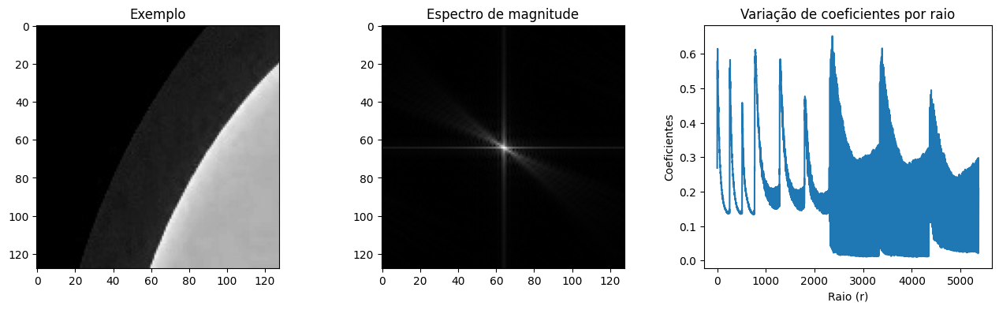

In [ ]:
example = 5
block = 0
x = input[example]

plt.figure(figsize=(16,4))
plt.subplot(131), plt.imshow(sliced_data[example, block,:,:], cmap='gray')
plt.title('Exemplo')
plt.subplot(132), plt.imshow(dft_data[example, block,:,:], cmap='gray')
plt.title('Espectro de magnitude')
plt.subplot(133), plt.plot(x)
plt.title('Variação de coeficientes por raio'), plt.xlabel('Raio (r)'), plt.ylabel('Coeficientes')
plt.show()

In [ ]:
folder = '/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels'
np.save(folder + '/input_train_odr2_l2_w1_square_fft', input)

In [ ]:
with tf.device('/CPU:0'):
  input_valid, sliced_data_valid, dft_data_valid = PreProcess(x_valid, 2, 1).processing()

level: 0
channel: 0
channel: 1
channel: 2
level: 1
channel: 0
channel: 1
channel: 2
level: 2
channel: 0
channel: 1
channel: 2


In [ ]:
input_valid.shape

TensorShape([117, 5376])

In [ ]:
folder = '/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels'
np.save(folder + '/input_valid_odr2_l2_w1_square_fft', input_valid)

In [ ]:
with tf.device('/CPU:0'):
  input_test, sliced_data_test, dft_data_test = PreProcess(x_test, 2, 1).processing()

level: 0
channel: 0
channel: 1
channel: 2
level: 1
channel: 0
channel: 1
channel: 2
level: 2
channel: 0
channel: 1
channel: 2


In [ ]:
input_test.shape ### test set shape 

TensorShape([349, 5376])

In [ ]:
sliced_data_test.shape #ultima parte do pre-processamento: 16 blocos 144x144

TensorShape([349, 16, 128, 128])

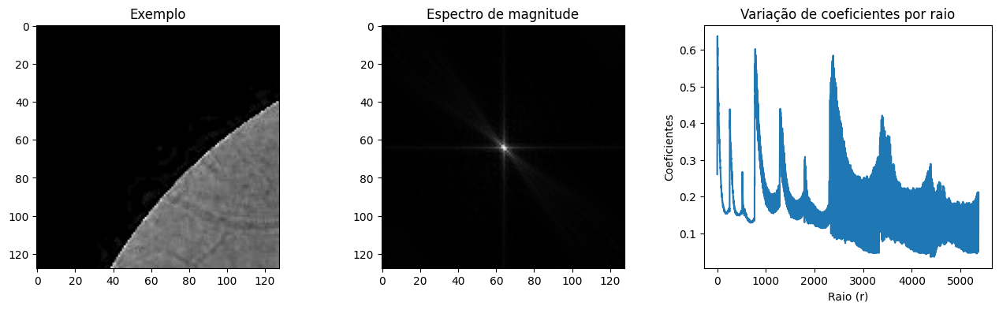

In [ ]:
example = 10
block = 0
x = input_test[example]

plt.figure(figsize=(16,4))
plt.subplot(131), plt.imshow(sliced_data_test[example, block,:,:], cmap='gray')
plt.title('Exemplo')
plt.subplot(132), plt.imshow(dft_data_test[example, block,:,:], cmap='gray')
plt.title('Espectro de magnitude')
plt.subplot(133), plt.plot(x)
plt.title('Variação de coeficientes por raio'), plt.xlabel('Raio (r)'), plt.ylabel('Coeficientes')
plt.show()

In [ ]:
folder = '/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels'
np.save(folder + '/input_test_odr2_l2_w1_square_fft', input_test)

#### Data Load

In [ ]:
### Saved Pre-Processed data LOAD ###

def LOAD(path_train=None, path_valid=None, path_test=None, extra_layers='Dense'):
  if extra_layers=='Dense':
    if path_valid!=False:
      input = tf.convert_to_tensor(np.load(path_train)) ### train 
      input_valid = tf.convert_to_tensor(np.load(path_valid)) ### valid
      input_test = tf.convert_to_tensor(np.load(path_test)) ### test
    else:
      input = tf.convert_to_tensor(np.load(path_train)) ### train 
      input_test = tf.convert_to_tensor(np.load(path_test)) ### test
  else:
    if path_valid!=False:
      input = tf.convert_to_tensor(np.load(path_train)) ### train 
      input = tf.expand_dims(input, -1)
      input_valid = tf.convert_to_tensor(np.load(path_valid)) ### valid
      input_valid = tf.expand_dims(input_valid, -1)
      input_test = tf.convert_to_tensor(np.load(path_test)) ### test
      input_test = tf.expand_dims(input_test, -1)
    else:
      input = tf.convert_to_tensor(np.load(path_train)) ### train 
      input = tf.expand_dims(input, -1)
      input_test = tf.convert_to_tensor(np.load(path_test)) ### test
      input_test = tf.expand_dims(input_test, -1)
  return input, input_valid, input_test

In [ ]:
input_train, input_valid, input_test = LOAD(path_train='/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/input_train_odr2_l2_w1_square_fft.npy', #v3
                                      path_valid='/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/input_valid_odr2_l2_w1_square_fft.npy',
                                      path_test='/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/input_test_odr2_l2_w1_square_fft.npy',
                                      extra_layers='Dense')

In [ ]:
input_test.shape # preprocessed data shape (here we have 2016 coefficients)

TensorShape([349, 5376])

In [ ]:
input_valid.shape

TensorShape([117, 5376])

In [ ]:
input_train.shape

TensorShape([705, 5376])

#### Custom Layer

In [ ]:
class FreqLayer(Layer):
  def __init__(self, units, kernel_initializer='RandomNormal', extra_layers='Dense', output_type='Dense', **kwargs):
    super().__init__(**kwargs)
    self.units = units
    self.kernel_initializer = kernel_initializer
    self.extra_layers = extra_layers
    self.output_type = output_type
  def get_config(self):
    config = super(FreqLayer, self).get_config()
    config.update({
      "units": self.units,
      "kernel_initializer": self.kernel_initializer,
      "extra_layers": self.extra_layers,
      "output_type": self.output_type
      })
    return config
  def build(self, batch_input_shape):
    if self.extra_layers == 'Dense':
      shape = [batch_input_shape[-1],self.units] #(weights,) - shape for dense training
    else:
      shape = [batch_input_shape[-2],1] #(weights, 1) - shape for convolutional training
    self.kernel = self.add_weight(
        name='kernel',
        shape = shape,
        initializer=self.kernel_initializer,
        trainable=True)
    super().build(batch_input_shape) # must be at the end
  def call(self, X):
    #### fourier and hartley convolution can be the same due to the filter even symmetry ####
    f = tf.expand_dims(X, -1)*self.kernel
    return f
  def compute_output_shape(self, batch_input_shape):
    if self.output_type == 'Dense':
      return tf.TensorShape(batch_input_shape.as_list()[:-1] + [self.units]) #[examples,1] - dense
    else:
      return tf.TensorShape(batch_input_shape.as_list()[:-2] + [self.units]) #[examples,1] - conv1d

#### Model

In [ ]:
### dense ###
tf.random.set_seed(11) #s
init = 'glorot_normal' #glorot_uniform 84%
function = 'LeakyReLU'
#function = tf.keras.layers.LeakyReLU(alpha=0.01)

model = Sequential([
    FreqLayer(1, kernel_initializer=tf.keras.initializers.RandomNormal(mean=0, stddev=0.0001)), #-2, 0.01
    Flatten(),
    Dense(4, activation=function,
          kernel_initializer=init, bias_initializer=init),
    #Dropout(0.1),
    #Dense(4, activation=function,
    #     kernel_initializer=init, bias_initializer=init),
    Dense(2, activation='softmax')])

In [ ]:
### inverse time decay  ###
bs=10
inversetime_decay = tf.keras.optimizers.schedules.InverseTimeDecay(
  initial_learning_rate = 0.1, #0.01
  decay_steps = input_train.shape[0]/bs,
  decay_rate = 0.01) #0.1

### optimizers ###
d_m=0.8 #momentum - dense layers #0.1

#opt1 = SGD(learning_rate=inversetime_decay, momentum=0.3) #84

opt2 = tfrs.experimental.optimizers.CompositeOptimizer([
      (SGD(learning_rate=inversetime_decay, momentum=0.0), lambda: [model.layers[0].kernel]),
      (SGD(learning_rate=inversetime_decay, momentum=d_m), lambda: model.layers[1].weights),
      (SGD(learning_rate=inversetime_decay, momentum=d_m), lambda: model.layers[2].weights),
      #(SGD(learning_rate=inversetime_decay, momentum=d_m), lambda: model.layers[3].weights),
      (SGD(learning_rate=inversetime_decay, momentum=d_m), lambda: model.layers[3].weights)]) #86

opt3 = Adam(learning_rate=inversetime_decay)

model.compile(optimizer=opt3, loss='categorical_crossentropy', metrics=['accuracy'])
#earlystop = tf.keras.callbacks.EarlyStopping(monitor='loss', min_delta=0, patience=500) # patience = 15
history = model.fit(input_train, y_train, validation_data=(input_valid, y_valid), epochs=500, batch_size=bs, verbose=1, shuffle=True) #validation_split=0.1

Epoch 1/500
71/71 [==============================] - 1s 6ms/step - loss: 0.7097 - accuracy: 0.6411 - val_loss: 0.3785 - val_accuracy: 0.8547
Epoch 2/500
71/71 [==============================] - 0s 4ms/step - loss: 0.3957 - accuracy: 0.8284 - val_loss: 0.2924 - val_accuracy: 0.8803
Epoch 3/500
71/71 [==============================] - 0s 4ms/step - loss: 0.4329 - accuracy: 0.8312 - val_loss: 0.5072 - val_accuracy: 0.7521
Epoch 4/500
71/71 [==============================] - 0s 3ms/step - loss: 0.4388 - accuracy: 0.8142 - val_loss: 0.7043 - val_accuracy: 0.7350
Epoch 5/500
71/71 [==============================] - 0s 4ms/step - loss: 0.9391 - accuracy: 0.7674 - val_loss: 1.0020 - val_accuracy: 0.4615
Epoch 6/500
71/71 [==============================] - 0s 4ms/step - loss: 0.7785 - accuracy: 0.8099 - val_loss: 0.4957 - val_accuracy: 0.7521
Epoch 7/500
71/71 [==============================] - 0s 3ms/step - loss: 0.5831 - accuracy: 0.8113 - val_loss: 0.4705 - val_accuracy: 0.8547
Epoch 8/500
7

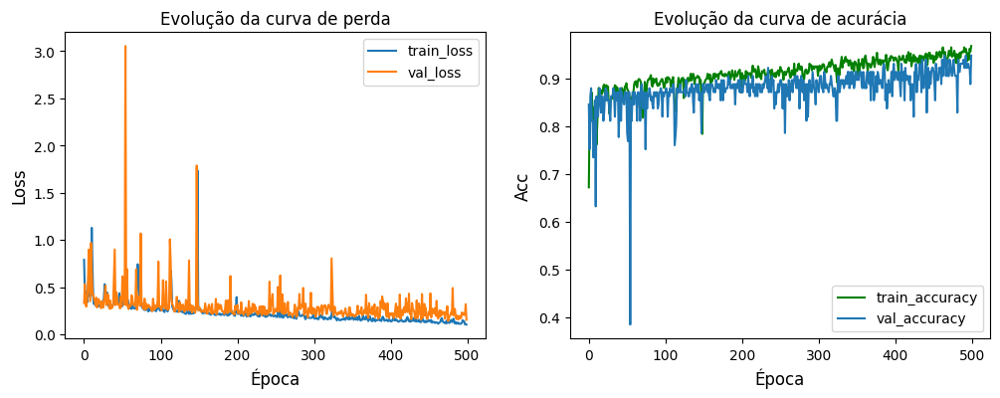

In [ ]:
plt.figure(figsize=(12,4))
plt.subplot(121), plt.plot(history.history['loss'], label='train_loss')
plt.subplot(121), plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Época', fontsize=12), plt.ylabel('Loss', fontsize=12)
plt.title('Evolução da curva de perda')
plt.legend()
plt.subplot(122), plt.plot(history.history['accuracy'], label = 'train_accuracy', color='green')
plt.subplot(122), plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Época', fontsize=12), plt.ylabel('Acc', fontsize=12)
plt.title('Evolução da curva de acurácia')
plt.legend()
plt.show()

In [ ]:
### TEST ACC ###
scores = model.evaluate(input_test, y_test)
print('\n%s : %.2f%%' % (model.metrics_names[1], scores[1] * 100))

11/11 [==============================] - 0s 3ms/step - loss: 0.3205 - accuracy: 0.9169

accuracy : 91.69%


11/11 [==============================] - 0s 2ms/step


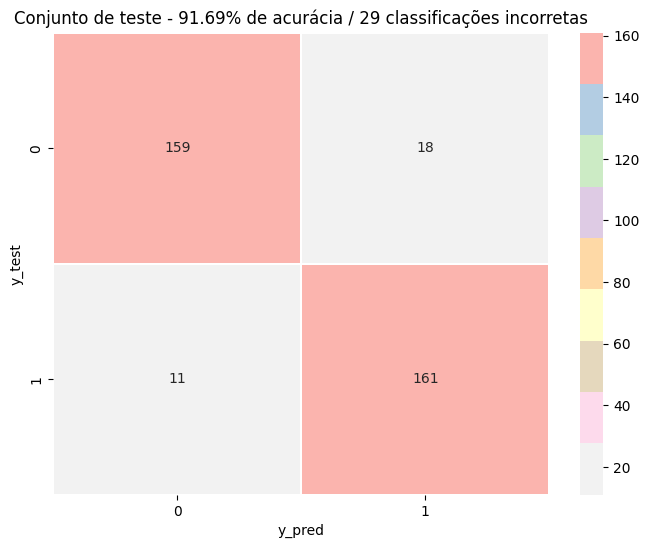

In [ ]:
y_pred = model.predict(input_test)
plt.figure(figsize = (8,6))
cm = confusion_matrix(tf.argmax(y_test, axis=1), tf.argmax(y_pred, axis=1))
acc = np.trace(cm)/input_test.shape[0] * 100
erros = tf.reduce_sum(cm)-tf.linalg.trace(cm)
plt.title('Conjunto de teste - %.2f%% de acurácia / %d classificações incorretas' % (acc, erros))
sn.heatmap(cm, cmap='Pastel1_r', linewidths=.1, annot=True,fmt=".3g")
plt.xlabel('y_pred')
plt.ylabel('y_test')
plt.show()

In [ ]:
np.savetxt('/content/drive/MyDrive/Mestrado/Experimentos/exp-retina/exp-retina-data/square-grouping/3_levels/cm_odr2.txt', cm)

In [ ]:
dic = {0:'normal',1:'cataract'} #normal=[1,0]; catarata=[0,1]

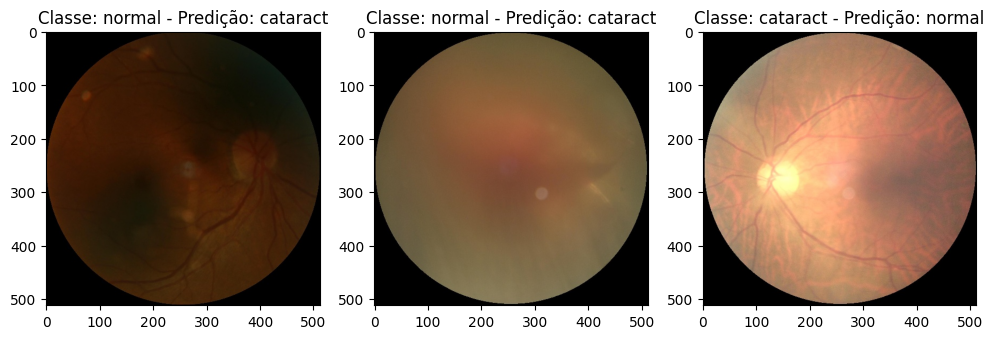

In [ ]:
dif = tf.argmax(y_test, axis=1)-tf.argmax(y_pred, axis=1)
indices = np.where(dif!=0)[0]

plt.figure(figsize=(12,6))
plt.subplot(131), plt.imshow(tf.squeeze(x_test[indices[0]]), cmap='gray')
r1 = tf.argmax(y_test, axis=1)[indices[0]]
f1 = tf.argmax(y_pred, axis=1)[indices[0]]
plt.title('Classe: %s - Predição: %s' % (dic[int(r1)], dic[int(f1)]))
plt.subplot(132), plt.imshow(tf.squeeze(x_test[indices[1]]), cmap='gray')
r2 = tf.argmax(y_test, axis=1)[indices[1]]
f2 = tf.argmax(y_pred, axis=1)[indices[1]]
plt.title('Classe: %s - Predição: %s' % (dic[int(r2)], dic[int(f2)]))
plt.subplot(133), plt.imshow(tf.squeeze(x_test[indices[2]]), cmap='gray')
r3 = tf.argmax(y_test, axis=1)[indices[2]]
f3 = tf.argmax(y_pred, axis=1)[indices[2]]
plt.title('Classe: %s - Predição: %s' % (dic[int(r3)], dic[int(f3)]))
plt.show()

In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 freq_layer_3 (FreqLayer)    (None, 5376, 1)           5376      
                                                                 
 flatten_3 (Flatten)         (None, 5376)              0         
                                                                 
 dense_6 (Dense)             (None, 4)                 21508     
                                                                 
 dense_7 (Dense)             (None, 2)                 10        
                                                                 
Total params: 26,894
Trainable params: 26,894
Non-trainable params: 0
_________________________________________________________________


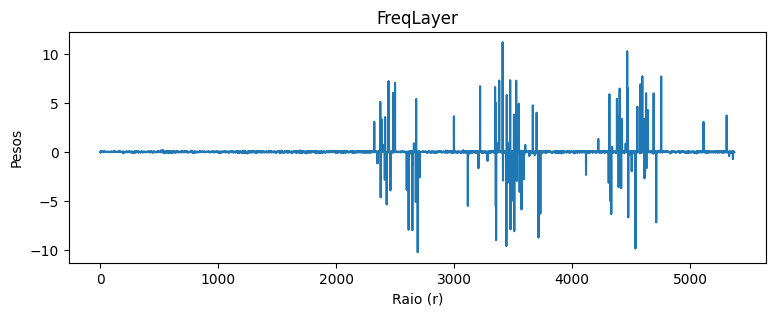

In [ ]:
plt.figure(figsize=(9,3))
plt.plot(model.get_weights()[0])
plt.title('FreqLayer')
plt.xlabel('Raio (r)'), plt.ylabel('Pesos')
plt.show()